# Africa Credit Challenge

The goals of this `starter notebook` are:

1. How to load data into a `Pandas` dataframe

2. How to `train` a basic machine learning model

3. How to `evaluate` the model

4. How to `save` your __submission__ following the required format.

<font color="red"><b>Note: This is just a starter notebook. It is by no means an ideal solution.</b></font>

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import f1_score, roc_auc_score
from sklearn.compose import ColumnTransformer
#from sklearn.preprocessing import StandardScaler
#from sklearn.ensemble import RandomForestClassifier
import warnings
warnings.filterwarnings('ignore')

## Load and Inspect the data

In [2]:
# Loading the train dataset
train = pd.read_csv('data/Train.csv')
test = pd.read_csv('data/Test.csv')

# Display the first few rows of the datasets and their shape
display("Train", train.head(), train.shape, "Test", test.head(), test.shape)

'Train'

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
0,ID_266671248032267278,266671,Kenya,248032,267278,Type_1,8448.0,8448.0,2022-08-30,2022-09-06,7,Repeat Loan,120.85,0.014305,121.0,0
1,ID_248919228515267278,248919,Kenya,228515,267278,Type_1,25895.0,25979.0,2022-07-30,2022-08-06,7,Repeat Loan,7768.50,0.300000,7794.0,0
2,ID_308486370501251804,308486,Kenya,370501,251804,Type_7,6900.0,7142.0,2024-09-06,2024-09-13,7,Repeat Loan,1380.00,0.200000,1428.0,0
3,ID_266004285009267278,266004,Kenya,285009,267278,Type_1,8958.0,9233.0,2022-10-20,2022-10-27,7,Repeat Loan,2687.40,0.300000,2770.0,0
4,ID_253803305312267278,253803,Kenya,305312,267278,Type_1,4564.0,4728.0,2022-11-28,2022-12-05,7,Repeat Loan,1369.20,0.300000,1418.0,0


(68654, 16)

'Test'

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid
0,ID_269404226088267278,269404,Kenya,226088,267278,Type_1,1919.0,1989.0,2022-07-27,2022-08-03,7,Repeat Loan,575.7,0.300000,597.0
1,ID_255356300042267278,255356,Kenya,300042,267278,Type_1,2138.0,2153.0,2022-11-16,2022-11-23,7,Repeat Loan,0.0,0.000000,0.0
2,ID_257026243764267278,257026,Kenya,243764,267278,Type_1,8254.0,8304.0,2022-08-24,2022-08-31,7,Repeat Loan,207.0,0.025079,208.0
3,ID_264617299409267278,264617,Kenya,299409,267278,Type_1,3379.0,3379.0,2022-11-15,2022-11-22,7,Repeat Loan,1013.7,0.300000,1014.0
4,ID_247613296713267278,247613,Kenya,296713,267278,Type_1,120.0,120.0,2022-11-10,2022-11-17,7,Repeat Loan,36.0,0.300000,36.0


(18594, 15)

In [3]:
# Check column types & missing values
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68654 entries, 0 to 68653
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   ID                           68654 non-null  object 
 1   customer_id                  68654 non-null  int64  
 2   country_id                   68654 non-null  object 
 3   tbl_loan_id                  68654 non-null  int64  
 4   lender_id                    68654 non-null  int64  
 5   loan_type                    68654 non-null  object 
 6   Total_Amount                 68654 non-null  float64
 7   Total_Amount_to_Repay        68654 non-null  float64
 8   disbursement_date            68654 non-null  object 
 9   due_date                     68654 non-null  object 
 10  duration                     68654 non-null  int64  
 11  New_versus_Repeat            68654 non-null  object 
 12  Amount_Funded_By_Lender      68654 non-null  float64
 13  Lender_portion_F

In [4]:
train.loc[:, train.columns != 'ID'].shape

(68654, 15)

In [5]:
train.loc[:, train.columns != 'ID']['tbl_loan_id'].value_counts()

tbl_loan_id
372036    2
367976    2
306263    2
367233    2
373890    2
         ..
255313    1
228837    1
279611    1
236311    1
268933    1
Name: count, Length: 66520, dtype: int64

## EDA

In [36]:
def plot_continuous(df, column, transform=None):
    """
    Plots visualizations for a continuous variable, showing the distribution and boxplot for both
    the original and transformed versions of the data.

    Args:
        df (pandas.DataFrame): The DataFrame containing the data.
        column (str): The column name of the continuous variable to plot.
        transform (str, optional): Transformation to apply to the data before plotting.
                                  Accepted values are 'log' or 'sqrt'. Default is None, which means no transformation.

    This function generates:
        - A histogram with a kernel density estimate (KDE) for the original data.
        - A boxplot for the original data.
        - If a transformation is specified ('log' or 'sqrt'):
            - A histogram with a KDE for the transformed data.
            - A boxplot for the transformed data.
    """
    # Create subplots for visualizations
    fig, axs = plt.subplots(2, 2, figsize=(15, 15))

    # Original data plots
    sns.histplot(df[column], kde=True, ax=axs[0, 0])
    axs[0, 0].set_title(f'Distribution of {column}')
    axs[0, 0].set_xlabel(column)

    sns.boxplot(y=df[column], ax=axs[1, 0])
    axs[1, 0].set_title(f'Box Plot of {column}')
    axs[1, 0].set_ylabel(column)

    # Transformations (log or square root)
    if transform == 'log':
        transformed_data = np.log1p(df[column])  # log1p handles log(0) gracefully
        transform_label = 'Log'
    elif transform == 'sqrt':
        transformed_data = np.sqrt(df[column])  # Square root transformation
        transform_label = 'Square Root'
    else:
        transformed_data = None  # No transformation if not specified

    # If transformed data exists, generate corresponding plots
    if transformed_data is not None:
        sns.histplot(transformed_data, kde=True, ax=axs[0, 1])
        axs[0, 1].set_title(f'{transform_label} Distribution of {column}')
        axs[0, 1].set_xlabel(f'{transform_label}({column})')

        sns.boxplot(y=transformed_data, ax=axs[1, 1])
        axs[1, 1].set_title(f'{transform_label} Box Plot of {column}')
        axs[1, 1].set_ylabel(f'{transform_label}({column})')
    else:
        # If no transformation, remove the second set of axes
        for ax in [axs[0, 1], axs[1, 1]]:
            ax.remove()

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()


def plot_categorical(df, column):
    """
    Plots visualizations for a categorical variable, including a bar plot and a pie chart.

    Args:
        df (pandas.DataFrame): The DataFrame containing the data.
        column (str): The column name of the categorical variable to plot.

    This function generates:
        - A bar plot showing the counts of each category in the specified column.
        - A pie chart showing the relative proportions of each category.
    """
    # Create subplots for visualizations
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

    # Bar plot showing counts of each category
    value_counts = df[column].value_counts()
    sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax1)
    ax1.set_title(f'Bar Plot of {column}')
    ax1.set_xlabel(column)
    ax1.set_ylabel('Count')
    ax1.tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

    # Pie chart showing percentage distribution of each category
    ax2.pie(value_counts.values, labels=value_counts.index, autopct='%1.1f%%')
    ax2.set_title(f'Pie Chart of {column}')

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()


### target

In [6]:
train['target'].value_counts(normalize=True) * 100

target
0    98.167623
1     1.832377
Name: proportion, dtype: float64

**IMBALANCED DATASET**

### customer_id

In [7]:
# Are there missing values in the train dataset ?
print(f"There are {train.isna().sum().sum()} missing values in the data.")

There are 0 missing values in the data.


In [8]:
# total number of rows
print(f"Train: {train.shape}")
print(f"Test: {test.shape}")

Train: (68654, 16)
Test: (18594, 15)


In [9]:
# Check unique customer_id
print(f"Train: {len(train['customer_id'].unique())} - {100 * len(train['customer_id'].unique())/train.shape[0]}")
print(f"Test: {len(test['customer_id'].unique())} - {100 * len(test['customer_id'].unique())/test.shape[0]}")

Train: 6540 - 9.526029073324205
Test: 4962 - 26.686027750887384


customer_id
247613    208
250874    192
259757    135
255356    128
249457    119
         ... 
246901      1
268437      1
273543      1
254894      1
248427      1
Name: count, Length: 6540, dtype: int64


<Axes: >

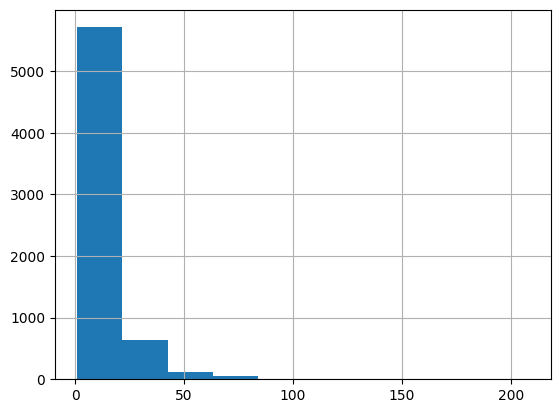

In [10]:
# Number of times a customer appears
print(train['customer_id'].value_counts())
train['customer_id'].value_counts().hist()

customer_id
296718    60
296758    55
296992    47
297596    46
296562    46
          ..
259117     1
246655     1
296580     1
239632     1
252341     1
Name: count, Length: 4962, dtype: int64


<Axes: >

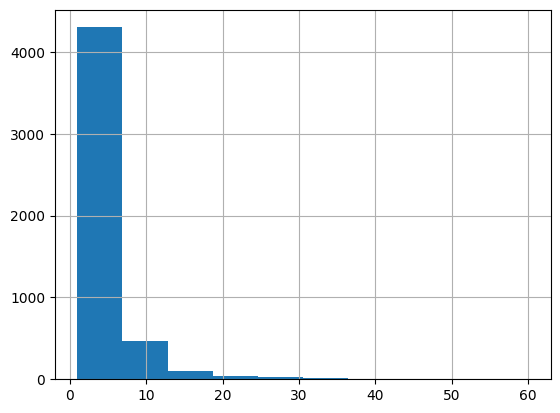

In [11]:
# Number of times a customer appears in test data
print(test['customer_id'].value_counts())
test['customer_id'].value_counts().hist()

In [12]:
customer_in_train_only = set(train['customer_id']) - set(test['customer_id'])
print(f"Number of customer in train only: {len(customer_in_train_only)}")

customer_in_test_only = set(test['customer_id']) - set(train['customer_id'])
print(f"Number of customer in test only: {len(customer_in_test_only)}")

Number of customer in train only: 2234
Number of customer in test only: 656


### customer_id VS target

In [16]:
pd.set_option('display.max_rows', train.shape[0]+1)

train[['customer_id', 'target']].groupby(['customer_id']) \
    .aggregate(['size', 'sum']) \
    .sort_values([('target', 'size')], ascending=False)

target    
              size sum
customer_id           
247613         208   0
250874         192   0
259757         135   0
255356         128   0
249457         119   0
262000         116   0
260083         115   0
253737         102   0
254014         101   0
246888         101   0
263235          99   0
247304          91   0
259729          90   0
249366          89   0
241430          88   0
258983          88   0
12897           88   0
249405          88   0
252103          85   0
241346          82   0
247038          81   0
248927          81   0
241647          80   0
249279          80   0
242329          79   0
262689          79   0
253927          78   0
262561          77   0
256361          76   0
245895          76   0
254227          76   0
263861          76   0
250153          76   0
240842          75   0
254128          75   0
257379          74   0
245095          74   0
259457          74   0
261570          74   0
258344          74   0
262903          73   0
265568          73   0
251897          73   0
247871          72   0
247850          72   0
257619          70   0
252775          70   0
264168          69   0
259525          69   0
243233          68   0
257889          68   0
261199          68   0
242351          67   0
254526          67   0
240047          67   0
250235          67   0
251105          66   0
246079          66   0
263585          65   0
240678          65   0
190905          65   0
251692          65   0
259693          64   0
252952          64   0
252492          64   0
239456          64   0
255130          63   0
263376          63   0
239491          62   0
254380          62   0
240359          62   0
266671          61   0
262962          61   0
255429          60   0
244565          60   0
8454            60   2
266568          60   0
250775          59   0
263180          59   0
263665          59   0
256201          59   0
262388          59   0
244757          58   0
261232          58   0
260863          58   0
253896          57   0
258074          57   0
265607          57   0
242995          57   0
252932          56   0
250994          56   0
260174          56   0
251200          56   0
256841          55   0
262240          55   0
260626          55   0
249996          55   0
261026          55   0
242775          55   0
253278          54   0
243976          54   0
241610          54   0
259835          54   0
242767          54   0
250357          54   0
249579          53   0
259611          53   0
264826          52   0
261487          52   0
261535          52   4
251410          52   0
266202          52   0
260969          52   0
259137          52   0
256054          51   0
250825          51   0
253136          51   0
260435          51   0
240798          51   0
252060          50   0
248895          50   0
253174          50   0
249583          50   0
267330          50   0
257301          50   0
251260          50   0
245353          49   0
258606          49   0
257273          48   0
251499          48   0
254671          48   0
257387          48   0
259749          47   0
256419          47   0
261145          47   0
266297          47   2
262550          47   0
213815          47   0
252537          47   0
248569          47   0
261746          47   0
259206          46   0
257099          46   0
253432          46   0
266801          46   0
261209          46   0
241573          46   0
243095          46   0
259241          46   0
259528          46   0
252690          46   0
257440          46   0
251769          46   0
253837          46   0
257613          46   0
266661          45   0
266419          45   0
256188          45   0
249259          45   0
259276          45   0
260007          45   1
239792          45   0
251741          45   0
241687          44   0
259880          44   0
242138          44   0
269496          44   0
250156          44   0
259876          44   0
249946          44   0
261406          44   0
259476    

In [18]:
# filter customer who has not defaulted at least once
pd.set_option('display.max_rows', train.shape[0]+1)

train[['customer_id', 'target']].groupby(['customer_id']) \
    .filter(lambda x: x.target.sum() > 0) \
    .groupby(['customer_id']) \
    .aggregate(['size', 'sum']) \
    .sort_values([('target', 'size')], ascending=False)

target    
              size sum
customer_id           
8454            60   2
261535          52   4
266297          47   2
260007          45   1
252513          37   1
246434          37   1
261104          36   1
260248          31   1
263482          30   1
261841          30   2
252807          28   1
252540          28   1
248375          28   1
243332          26   2
256615          25   2
249229          25   2
259636          25   1
100464          24   2
252536          24   1
251644          24   2
308977          23   2
258228          23   2
241828          23   2
262040          23   1
248684          22   2
256554          21   1
242918          21   1
245399          20   1
248853          20   1
270766          20   1
246550          20   2
269118          20   1
269822          19   1
310119          19   2
308629          19   2
253353          19   1
245435          19   2
245968          19   1
250594          19   1
249194          19   2
309363          19   2
243598          18   1
252905          18   1
97633           18   1
308377          18   2
249309          18   2
263718          18   2
273307          18  13
308504          17   2
249931          17   2
244279          17   2
199820          17   2
261588          16   1
308579          16   2
268660          16   1
250307          16   1
309041          16   2
247838          16   2
99358           16   1
248850          16   1
247643          16   1
246549          16   2
248456          16   2
259139          16   1
256582          15   2
270823          15   1
268400          15   1
261581          15   2
252841          15   1
261493          15   1
262395          15   2
308870          15   2
268938          15   1
245623          15   1
263945          14   1
241824          14   1
256868          14   2
269735          14   2
308506          14   1
247625          14   1
246051          14   1
251616          14   2
258861          14   1
247158          14   1
247107          14   2
238927          14   2
246091          14   2
238716          14   1
251748          14   1
272717          14   6
264000          14   1
244219          13   3
308885          13   2
249176          13   1
266265          13   1
254032          13   1
253524          13   1
260384          13   1
268566          13   1
308909          13   2
240065          13   2
245876          13   1
243129          13   2
269326          12   2
249418          12   1
271305          12   2
262477          12   1
308502          12   2
311529          12   2
246777          12   1
243588          12   1
309144          12   2
260006          12   1
308959          12   2
248670          12   1
258764          12   1
260101          12   1
248255          12   1
266788          12   1
309060          12   2
257780          12   1
238063          12   1
309071          11   1
308934          11   2
270682          11   1
265690          11   2
258103          11   1
308974          11   4
262061          11   1
245220          11   4
288739          11   1
250297          11   1
249830          11   2
245154          11   1
261204          11   1
266723          11   2
246915          11   1
261118          11   1
271163          11   1
309066          11   2
244876          11   1
247695          11   1
268784          11   1
266994          11   2
251474          10   1
262415          10   1
251199          10   1
238342          10   2
265290          10   1
265632          10   1
273584          10   2
256869          10   1
264959          10   1
273705          10   2
269445          10   1
270169          10   2
250155          10   1
288743          10   2
242044          10   2
267947          10   2
254249          10   1
244754          10   1
249235           9   1
248615           9   2
264470           9   2
263193           9   1
308430           9   2
263326           9   1
247169           9   1
288536           9   1
308449           9   2
245448    

We can understand that
- there are people who didn't default on their first loan
- there are people who didn't default on each of their loan
- other didn't default on some (rare) laon

### country_id

In [19]:
train['country_id'].value_counts(normalize=True) * 100

country_id
Kenya    100.0
Name: proportion, dtype: float64

In [20]:
test['country_id'].value_counts(normalize=True) * 100

country_id
Kenya    81.042272
Ghana    18.957728
Name: proportion, dtype: float64

only one country represented in train data but two in test data.
we will categorize it with unknown label for not seen label

### tbl_loan_id

In [21]:
len(train['tbl_loan_id'].unique())

66520

In [22]:
train.shape

(68654, 16)

In [23]:
train['tbl_loan_id'].value_counts()

tbl_loan_id
372036    2
367976    2
306263    2
367233    2
373890    2
370248    2
368197    2
367537    2
360792    2
371807    2
357580    2
305974    2
371710    2
306392    2
368070    2
298920    2
374021    2
369841    2
368027    2
250345    2
370215    2
367184    2
368888    2
373445    2
371298    2
367550    2
370955    2
272758    2
360480    2
360237    2
204356    2
288758    2
307124    2
367816    2
367075    2
306026    2
359752    2
369515    2
373639    2
374275    2
249827    2
372821    2
369214    2
367345    2
372944    2
370257    2
280681    2
372950    2
209148    2
306020    2
240451    2
369765    2
303324    2
238816    2
369583    2
306061    2
306525    2
367936    2
357479    2
374089    2
374276    2
372438    2
369834    2
272958    2
374265    2
270087    2
374728    2
306159    2
374057    2
289067    2
369725    2
367935    2
375290    2
370603    2
283999    2
292909    2
367992    2
306372    2
369696    2
367604    2
307438    2
367329    2
3604

We are supposed to have an unique loan_id. But most of them are double.

In [24]:
train[train['tbl_loan_id'] == 372036]

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
17147,ID_308989372036251804,308989,Kenya,372036,251804,Type_7,37700.0,39020.0,2024-09-27,2024-10-04,7,Repeat Loan,7540.0,0.2,7804.0,0
61856,ID_308989372036267278,308989,Kenya,372036,267278,Type_7,37700.0,39020.0,2024-09-27,2024-10-04,7,Repeat Loan,7540.0,0.2,7804.0,0


In [29]:
train.shape

(68654, 16)

In [30]:
# check for number of duplicate
# train.loc[:, train.columns != 'ID'].drop_duplicates()
train = train.drop_duplicates(subset=['tbl_loan_id'], keep=False)
train.shape

(64386, 16)

Because of the duplicated rows found, we have to re-run all the previous analysis

In [31]:
train['tbl_loan_id'].value_counts()

tbl_loan_id
248032    1
281747    1
292377    1
229288    1
227827    1
287606    1
274987    1
224322    1
229501    1
298740    1
127754    1
262448    1
295475    1
232027    1
228596    1
241077    1
243491    1
273210    1
267124    1
280676    1
248884    1
227614    1
219886    1
272238    1
247992    1
233199    1
302957    1
240354    1
232023    1
214301    1
302653    1
301448    1
223276    1
241766    1
245289    1
228568    1
277128    1
288876    1
216304    1
223062    1
242365    1
251510    1
114828    1
218843    1
250730    1
240190    1
303845    1
256310    1
278821    1
247106    1
231384    1
256233    1
272573    1
287054    1
301599    1
301699    1
266921    1
227100    1
232276    1
279632    1
230381    1
274870    1
281534    1
242258    1
218058    1
271528    1
289022    1
287227    1
281373    1
233586    1
256939    1
295605    1
226445    1
241845    1
215762    1
299569    1
293243    1
303322    1
233438    1
249142    1
255033    1
244393    1
2893

No more duplicated rows

In [35]:
train.to_csv("data/train_no_duplicates.csv", index=False)

### Total_Amount

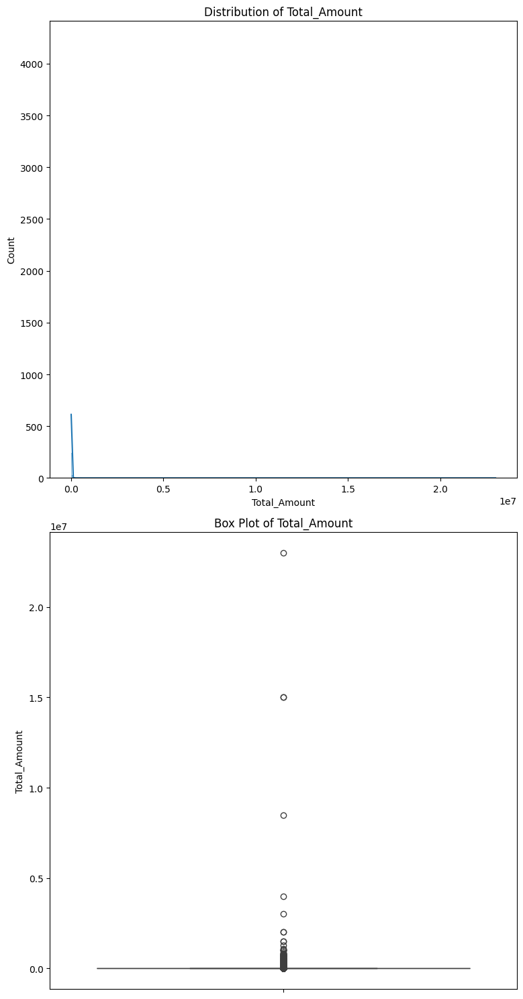

In [38]:
plot_continuous(train, 'Total_Amount')

Skewed at right

Let's check if there is a relationship between `Total_Amount` and `target`

<Axes: xlabel='target', ylabel='Total_Amount'>

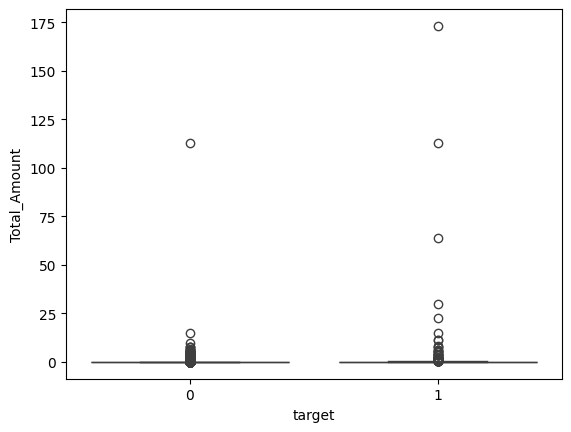

In [52]:
m = train['Total_Amount'].mean()
s = train['Total_Amount'].std()

sns.boxplot(y=train['Total_Amount'].apply(lambda x: (x - m)/s), x=train['target'])

### Total_Amount_to_Repay

<Axes: xlabel='Total_Amount_to_Repay', ylabel='Count'>

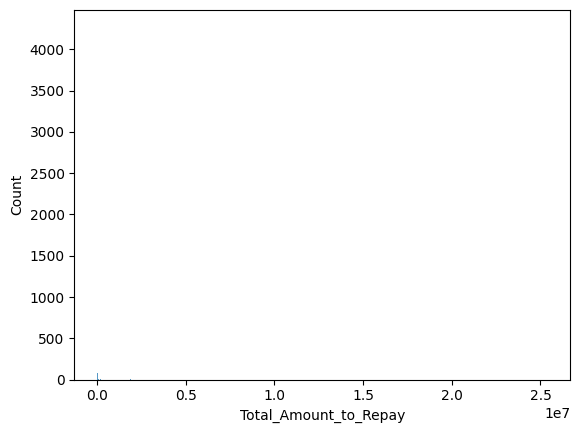

In [57]:
sns.histplot(x=train['Total_Amount_to_Repay'])

<Axes: xlabel='target', ylabel='Total_Amount_to_Repay'>

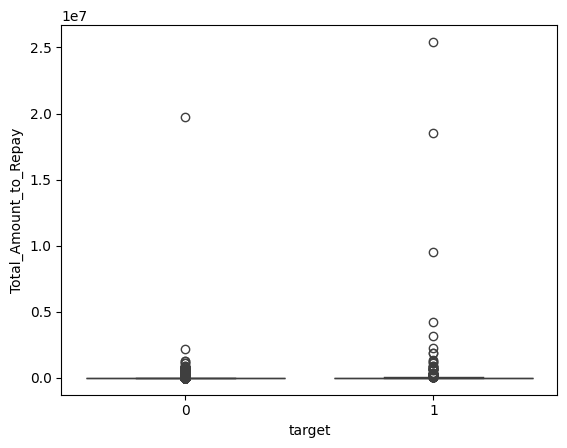

In [59]:
sns.boxplot(y=train['Total_Amount_to_Repay'], x=train['target'])

<Axes: xlabel='Total_Amount', ylabel='Total_Amount_to_Repay'>

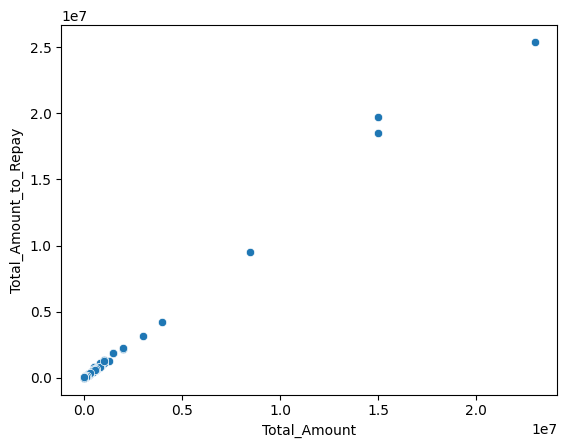

In [60]:
sns.scatterplot(data=train, x='Total_Amount', y='Total_Amount_to_Repay')

<Axes: xlabel='Total_Amount', ylabel='Total_Amount_to_Repay'>

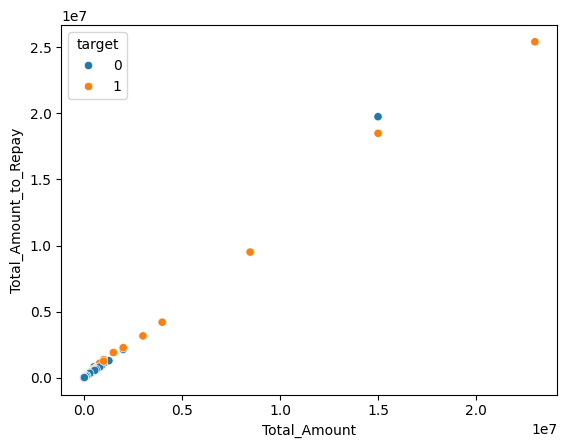

In [62]:
sns.scatterplot(data=train, x='Total_Amount', y='Total_Amount_to_Repay', hue='target')

   Total_Amount  Total_Amount_to_Repay  target
0     -0.028684              -0.027882       0
1      0.102731               0.084411       0
2     -0.040344              -0.036247       0
3     -0.024842              -0.022853       0
4     -0.057939              -0.051710       0


<Axes: xlabel='Total_Amount', ylabel='Total_Amount_to_Repay'>

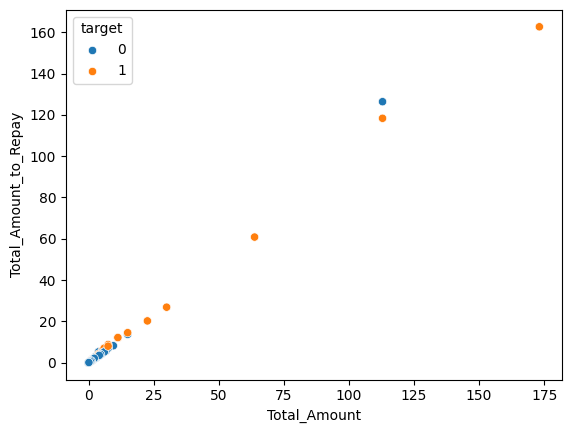

In [68]:
amount = train[['Total_Amount', 'Total_Amount_to_Repay']]
amount = (amount - amount.mean())/amount.std()
amount['target'] = train['target']

print(amount.head())

sns.scatterplot(data=amount, x='Total_Amount', y='Total_Amount_to_Repay', hue='target')
# plt.plot(amount['Total_Amount'], amount['Total_Amount_to_Repay'])

It seems like the loan is not defaulted for higher amount

Let's check that by looking at the mean

In [69]:
train['target'].value_counts()

target
0    63482
1      904
Name: count, dtype: int64

In [73]:
train.groupby(['target'])[['Total_Amount', 'Total_Amount_to_Repay']].aggregate(['mean', 'std'])

Total_Amount                Total_Amount_to_Repay              
                mean            std                  mean           std
target                                                                 
0        10990.75746   64834.281260          11299.508890  8.296967e+04
1       101115.87479  976330.615797         118228.401836  1.114716e+06

`Target = 1` for an average amount of more than 100.000

`Target = 0` for an average amount of 10.000

In [88]:
# amount = train[['Total_Amount', 'Total_Amount_to_Repay', 'target']]
amount = train[['Total_Amount', 'Total_Amount_to_Repay']]
amount = (amount - amount.mean())/amount.std()

amount['target'] = train['target']
amount['difference'] = amount['Total_Amount'] - amount['Total_Amount_to_Repay']
amount['div'] = amount['Total_Amount']/amount['Total_Amount_to_Repay']

amount[amount.target == 1].sort_values(['div'], ascending=False) #[['Total_Amount', 'Total_Amount_to_Repay']]

,Total_Amount,Total_Amount_to_Repay,target,difference,div
35125,-0.024564,-0.000313,1,-0.024251,78.543354
45761,-0.011254,-0.000468,1,-0.010786,24.033997
45657,-0.023328,-0.001101,1,-0.022228,21.196043
50609,-0.038205,-0.003016,1,-0.035189,12.668097
56280,-0.015872,-0.001543,1,-0.014329,10.288975
64908,-0.026786,-0.002836,1,-0.023949,9.443359
59,-0.005695,-0.000627,1,-0.005069,9.089385
40040,-0.023991,-0.003093,1,-0.020899,7.757443
43293,-0.016994,-0.003003,1,-0.013991,5.658942
26297,-0.029399,-0.005949,1,-0.023450,4.941512


In [89]:
amount[amount.target == 0].sort_values(['div'], ascending=False)

,Total_Amount,Total_Amount_to_Repay,target,difference,div
19481,0.003238,0.000001,0,3.236671e-03,2883.382874
60289,0.001287,0.000001,0,1.285816e-03,1146.070308
59445,0.002959,0.000008,0,2.951572e-03,393.063011
43874,0.001701,0.000014,0,1.687280e-03,122.093406
42084,0.004149,0.000040,0,4.109641e-03,104.896136
62496,0.004157,0.000046,0,4.110768e-03,90.440977
31767,0.004157,0.000046,0,4.110768e-03,90.440977
34168,0.004164,0.000052,0,4.111895e-03,79.522115
18291,0.003019,0.000059,0,2.960587e-03,51.374557
1619,0.003607,0.000072,0,3.535292e-03,50.387822


<Axes: xlabel='difference', ylabel='div'>

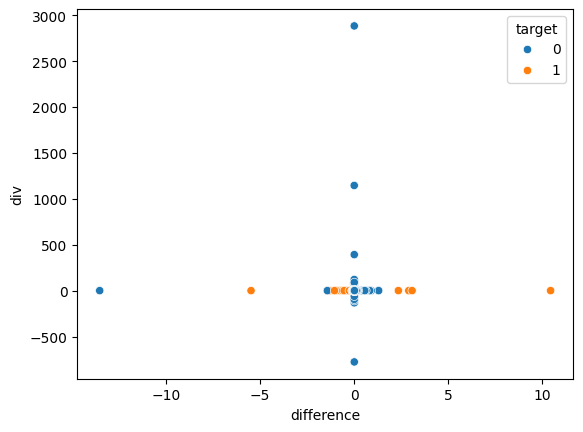

In [90]:
sns.scatterplot(data = amount, x='difference', y='div', hue='target')

<Axes: xlabel='difference', ylabel='Total_Amount'>

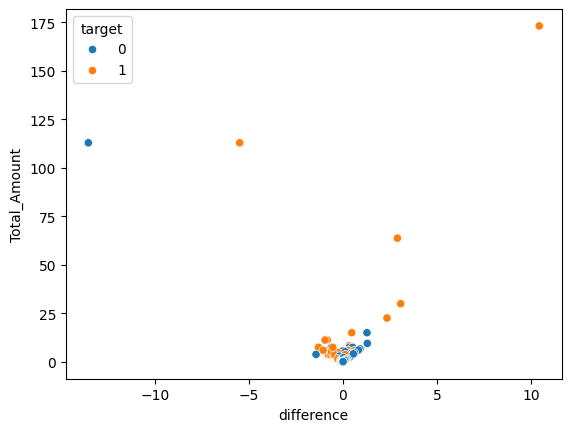

In [93]:
sns.scatterplot(data=amount, y='Total_Amount', x='difference', hue='target')

<Axes: xlabel='difference', ylabel='Total_Amount_to_Repay'>

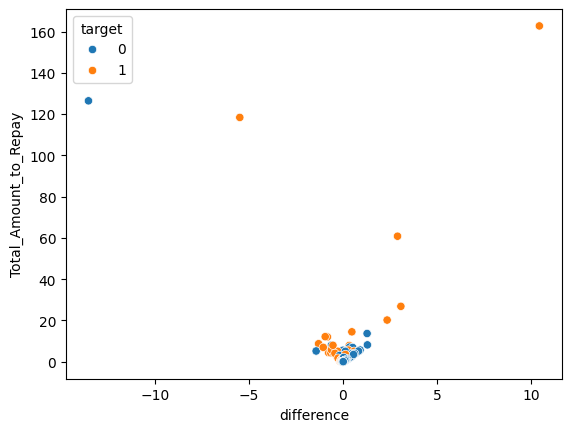

In [94]:
sns.scatterplot(data=amount, y='Total_Amount_to_Repay', x='difference', hue='target')

<Axes: xlabel='div', ylabel='Total_Amount'>

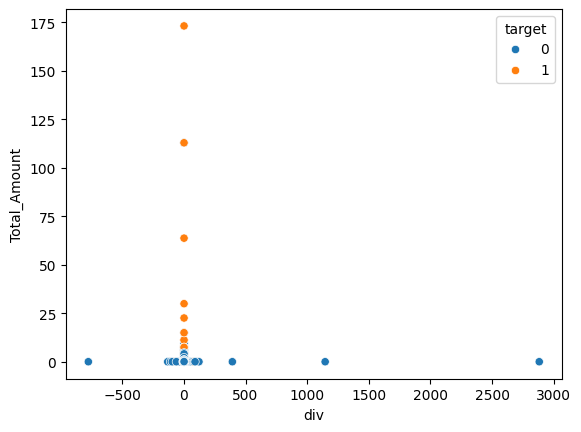

In [95]:
sns.scatterplot(data=amount, y='Total_Amount', x='div', hue='target')

<Axes: xlabel='div', ylabel='Total_Amount_to_Repay'>

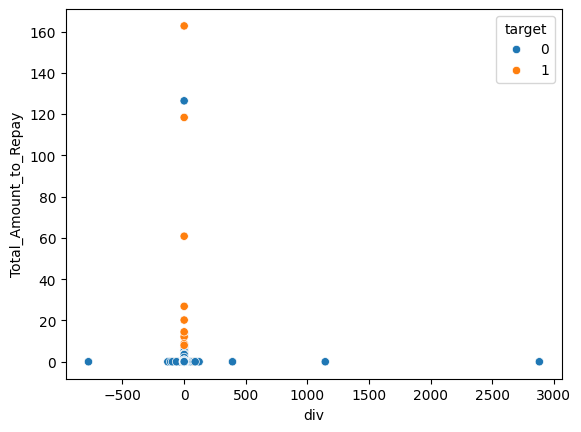

In [96]:
sns.scatterplot(data=amount, y='Total_Amount_to_Repay', x='div', hue='target')

We notice that `target = 1` fOR `div ~ 0` (around 0)

We can see that from the two previous scatterplot.

Same observation also when we see the scatterplot between `div` and `difference`

### loan_type

In [98]:
train['loan_type'].value_counts()

loan_type
Type_1     61723
Type_5       811
Type_4       509
Type_7       502
Type_9       205
Type_10      172
Type_6       153
Type_14       99
Type_2        74
Type_11       42
Type_18       30
Type_12       21
Type_20       13
Type_13       10
Type_23        6
Type_15        4
Type_21        3
Type_17        3
Type_24        3
Type_19        2
Type_22        1
Name: count, dtype: int64

In [100]:
pd.crosstab(train['loan_type'], train['target']).sort_values(['loan_type'])

target,0,1
loan_type,,
Type_1,61203,520
Type_10,166,6
Type_11,40,2
Type_12,20,1
Type_13,10,0
Type_14,28,71
Type_15,1,3
Type_17,3,0
Type_18,29,1


### disbursement_date

In [101]:
train.sort_values(['customer_id'])

customer_id
145         1
161         1
166         1
1487        1
4534        2
6083        3
7154       14
7411       38
7651        8
8256        2
8454       60
8532        3
10191       1
12276       1
12897      88
12921       1
13233       1
14362      30
14667       2
14932       9
15493       1
16640       1
17894       5
18760       1
20258       1
20980       1
22867       1
23020       2
23284       1
24142       1
24562       1
25626       1
26464       3
27525       1
28083       1
28428      13
29290       1
32272       1
32510       1
33419       1
34369       1
34823       6
35394       1
36291       1
40047      16
41868       1
42928       1
43115       8
44393       1
44564       1
44568      16
44627       1
46581       1
48830       1
50984       1
51317       1
52587       1
52751      10
52961      37
52971       1
53370       1
53429       4
53802       1
54179       1
55853       2
57484      19
59613       1
60275       1
62030       4
63823       4
65254   

In [104]:
train[train['customer_id'] == 7411].sort_values(['disbursement_date'])

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
47285,ID_7411214204267278,7411,Kenya,214204,267278,Type_1,10998.0,10998.0,2022-07-12,2022-07-19,7,Repeat Loan,5499.00,0.500000,5499.0,0
27741,ID_7411215162267278,7411,Kenya,215162,267278,Type_1,8166.0,8166.0,2022-07-13,2022-07-20,7,Repeat Loan,2449.80,0.300000,2450.0,0
1780,ID_7411216467267278,7411,Kenya,216467,267278,Type_1,7039.0,7039.0,2022-07-15,2022-07-22,7,Repeat Loan,2111.70,0.300000,2112.0,0
43898,ID_7411222401267278,7411,Kenya,222401,267278,Type_1,10498.0,10561.0,2022-07-22,2022-07-29,7,Repeat Loan,3149.40,0.300000,3168.0,0
9937,ID_7411224479267278,7411,Kenya,224479,267278,Type_1,7524.0,7524.0,2022-07-25,2022-08-01,7,Repeat Loan,2257.20,0.300000,2257.0,0
4039,ID_7411226201267278,7411,Kenya,226201,267278,Type_1,5099.0,5099.0,2022-07-27,2022-08-03,7,Repeat Loan,1529.70,0.300000,1530.0,0
9676,ID_7411227588267278,7411,Kenya,227588,267278,Type_1,5099.0,5099.0,2022-07-29,2022-08-05,7,Repeat Loan,1529.70,0.300000,1530.0,0
63341,ID_7411228842267278,7411,Kenya,228842,267278,Type_1,10038.0,10038.0,2022-07-30,2022-08-06,7,Repeat Loan,3011.40,0.300000,3011.0,0
10709,ID_7411229870267278,7411,Kenya,229870,267278,Type_1,4958.0,4958.0,2022-08-01,2022-08-08,7,Repeat Loan,1487.40,0.300000,1487.0,0
65235,ID_7411231405267278,7411,Kenya,231405,267278,Type_1,1170.0,1170.0,2022-08-03,2022-08-10,7,Repeat Loan,351.00,0.300000,351.0,0


In [105]:
train[train['target'] == 1]['customer_id'].value_counts()

customer_id
273307    5
272717    4
246360    4
261535    4
238231    3
242121    3
238341    2
100464    2
241961    2
256615    2
243129    2
256740    2
263718    2
266723    2
245435    2
258228    2
242044    2
266994    2
250887    2
262395    2
266700    2
248615    2
246655    2
265055    2
8454      2
267947    2
270916    2
242744    2
271305    2
265690    2
249136    2
254148    2
198718    2
246091    2
266297    2
269895    2
257035    2
269166    2
247537    2
241828    2
270476    2
269735    2
256353    2
245011    1
261741    1
294738    1
257625    1
238249    1
247169    1
243672    1
264792    1
268092    1
246175    1
309504    1
258547    1
259543    1
246818    1
125271    1
238436    1
308497    1
260101    1
245154    1
84031     1
263945    1
241626    1
24142     1
253678    1
226257    1
266896    1
176600    1
257747    1
250594    1
306376    1
253391    1
253684    1
292317    1
99358     1
273490    1
248120    1
308507    1
265665    1
252968    1
2733

In [106]:
train[train['customer_id'] == 273307].sort_values('disbursement_date')

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
2217,ID_273307306402267277,273307,Kenya,306402,267277,Type_23,558707.0,588039.12,2023-01-19,2023-04-19,90,Repeat Loan,10000.0,0.017898,10525.0,1
27926,ID_273307306401267277,273307,Kenya,306401,267277,Type_23,266698.0,280699.65,2023-01-19,2023-04-19,90,Repeat Loan,9000.0,0.033746,9473.0,1
54475,ID_273307306634267278,273307,Kenya,306634,267278,Type_23,3986325.0,4205572.88,2023-02-14,2023-05-15,90,Repeat Loan,500000.0,0.125429,527500.0,1
50738,ID_273307306678251804,273307,Kenya,306678,251804,Type_23,766043.0,807026.31,2023-02-17,2023-05-18,90,Repeat Loan,100000.0,0.130541,105350.0,1
36941,ID_273307306702251804,273307,Kenya,306702,251804,Type_23,3006566.0,3167417.28,2023-02-21,2023-05-22,90,Repeat Loan,100000.0,0.033261,105350.0,1
56114,ID_273307306839267278,273307,Kenya,306839,267278,Type_23,581533.0,610609.84,2023-03-07,2023-06-05,90,Repeat Loan,100000.0,0.171959,105000.0,0


In [107]:
train[train['customer_id'] == 272717].sort_values('disbursement_date')

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
354,ID_272717296238251804,272717,Kenya,296238,251804,Type_10,60007.79,60907.91,2022-11-09,2022-11-30,21,Repeat Loan,9599.00,0.159963,9743.0,0
64082,ID_272717306087251804,272717,Kenya,306087,251804,Type_10,52986.45,53781.25,2022-12-10,2022-12-31,21,Repeat Loan,8476.00,0.159965,8603.0,0
5279,ID_272717306208251804,272717,Kenya,306208,251804,Type_10,149762.94,152009.38,2022-12-23,2022-12-31,8,Repeat Loan,23652.00,0.157930,24007.0,0
33613,ID_272717306811251804,272717,Kenya,306811,251804,Type_10,82844.25,84086.91,2023-03-02,2023-04-16,45,Repeat Loan,11609.00,0.140130,11783.0,0
63760,ID_272717306982251804,272717,Kenya,306982,251804,Type_10,202170.41,205202.97,2023-04-02,2023-05-17,45,Repeat Loan,16207.98,0.080170,16451.0,1
2747,ID_272717307125251804,272717,Kenya,307125,251804,Type_10,168179.49,170702.18,2023-05-04,2023-06-18,45,Repeat Loan,10090.00,0.059995,10241.0,1
58142,ID_272717307270251804,272717,Kenya,307270,251804,Type_10,138097.73,140169.20,2023-06-03,2023-07-18,45,Repeat Loan,7689.00,0.055678,7804.0,1
46463,ID_272717357529267278,272717,Kenya,357529,267278,Type_10,67393.00,68403.94,2023-08-04,2023-09-15,42,Repeat Loan,915.00,0.013577,929.0,1


In [108]:
train[train['customer_id'] == 246360].sort_values('disbursement_date')

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
14168,ID_246360224064267278,246360,Kenya,224064,267278,Type_1,4737.0,4898.0,2022-07-25,2022-08-01,7,Repeat Loan,1421.1,0.3,1469.0,0
32286,ID_246360224067267278,246360,Kenya,224067,267278,Type_1,839.0,870.0,2022-07-25,2022-08-01,7,Repeat Loan,251.7,0.3,261.0,0
11838,ID_246360233640267278,246360,Kenya,233640,267278,Type_1,350.0,639.0,2022-08-08,2022-08-15,7,Repeat Loan,105.0,0.3,192.0,1
34514,ID_246360233639267278,246360,Kenya,233639,267278,Type_1,380.0,679.0,2022-08-08,2022-08-15,7,Repeat Loan,114.0,0.3,204.0,1
45667,ID_246360233636267278,246360,Kenya,233636,267278,Type_1,1518.0,2409.0,2022-08-08,2022-08-15,7,Repeat Loan,455.4,0.3,723.0,1
59311,ID_246360233634267278,246360,Kenya,233634,267278,Type_1,5616.0,6629.0,2022-08-08,2022-08-15,7,Repeat Loan,1684.8,0.3,1989.0,1


In [109]:
train[train['customer_id'] == 238231].sort_values('disbursement_date')

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
13091,ID_238231117613251804,238231,Kenya,117613,251804,Type_4,70000.0,81449.0,2022-02-18,2022-05-19,90,Repeat Loan,11200.00,0.160000,13032.0,0
48858,ID_238231162876251804,238231,Kenya,162876,251804,Type_4,85000.0,93568.0,2022-05-11,2022-08-09,90,Repeat Loan,13134.17,0.154520,15115.0,1
16489,ID_238231225489251804,238231,Kenya,225489,251804,Type_4,47200.0,51920.0,2022-07-27,2022-10-25,90,Repeat Loan,9440.00,0.200000,10856.0,0
4327,ID_238231264545267278,238231,Kenya,264545,267278,Type_4,80000.0,88068.0,2022-09-21,2022-12-21,91,Repeat Loan,20618.36,0.257730,23729.0,1
48054,ID_238231300515267278,238231,Kenya,300515,267278,Type_4,78000.0,85868.0,2022-11-17,2023-02-17,92,Repeat Loan,10400.00,0.133333,11969.0,1
57445,ID_238231306341267278,238231,Kenya,306341,267278,Type_4,80000.0,92000.0,2023-01-11,2023-04-11,90,Repeat Loan,10666.00,0.133325,12266.0,0


In [110]:
train[train['customer_id'] == 242121].sort_values('disbursement_date')

,ID,customer_id,country_id,tbl_loan_id,lender_id,loan_type,Total_Amount,Total_Amount_to_Repay,disbursement_date,due_date,duration,New_versus_Repeat,Amount_Funded_By_Lender,Lender_portion_Funded,Lender_portion_to_be_repaid,target
43896,ID_242121117609251804,242121,Kenya,117609,251804,Type_4,60000.0,64200.0,2022-02-18,2022-03-20,30,Repeat Loan,6315.32,0.105255,6757.0,0
54237,ID_242121124133251804,242121,Kenya,124133,251804,Type_4,80000.0,85410.0,2022-03-09,2022-05-08,60,Repeat Loan,12800.00,0.160000,14498.0,1
2458,ID_242121161171251804,242121,Kenya,161171,251804,Type_4,150000.0,157729.0,2022-05-10,2022-08-08,90,Repeat Loan,17645.49,0.117637,20319.0,1
65288,ID_242121187544267278,242121,Kenya,187544,267278,Type_4,180000.0,188329.0,2022-06-13,2022-09-11,90,Repeat Loan,28800.00,0.160000,32725.0,1
22553,ID_242121214946267278,242121,Kenya,214946,267278,Type_4,200000.0,212000.0,2022-07-13,2022-09-11,60,Repeat Loan,53333.00,0.266665,59733.0,0
12986,ID_242121245381251804,242121,Kenya,245381,251804,Type_4,240000.0,276000.0,2022-08-27,2022-11-25,90,Repeat Loan,16183.37,0.067431,18611.0,0


#### Categorical exploration

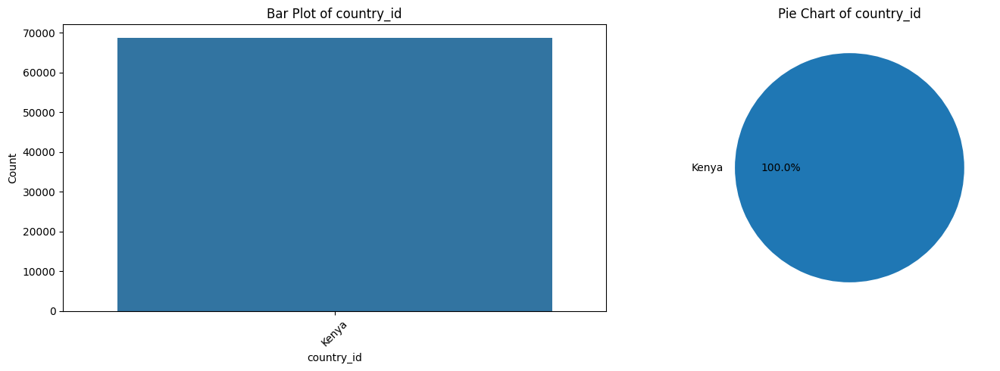

In [6]:
plot_categorical(train, 'country_id')

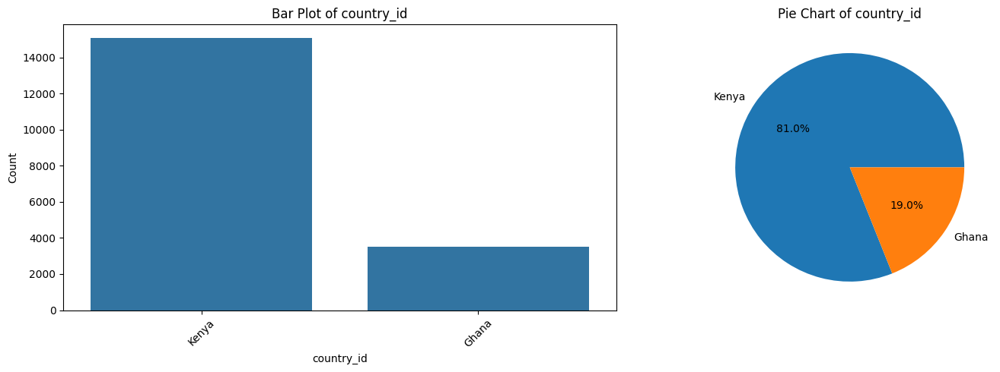

In [7]:
plot_categorical(test, 'country_id')

##### This shows that test has a new country, ghana so one of the goals is to build a solution that can generalize well in new regions

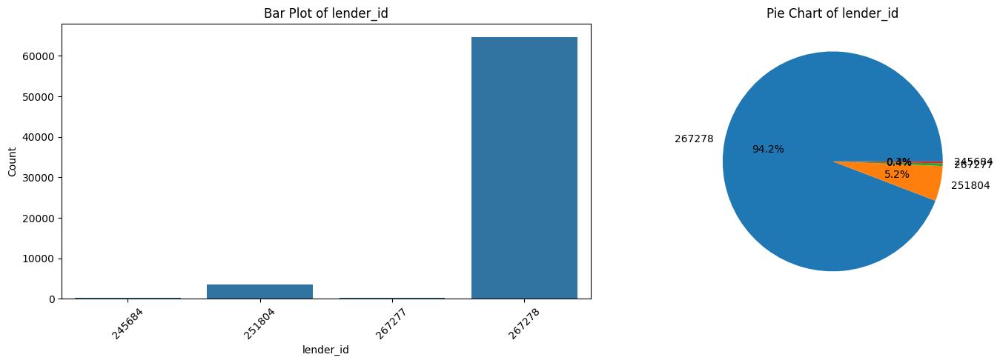

In [8]:
plot_categorical(train, 'lender_id')

##### You can exploree more of the categorical columns as well

#### TARGET EXPLORATION


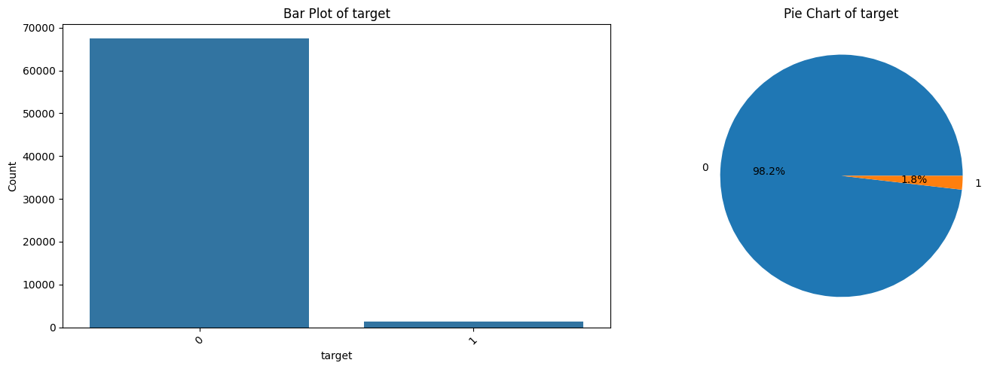

In [9]:
plot_categorical(train, 'target')

##### You can see the dataset is highly imbalanced , and this is expected in loan default scenarios, So find  ways to deal with the  imbalance

### CONTINUOUS COLUMN EXPLORATION

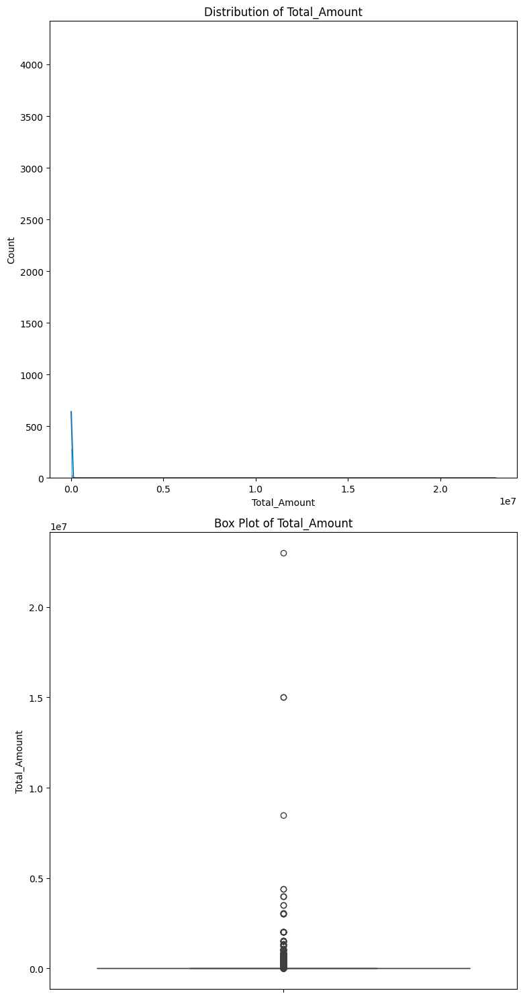

In [10]:
plot_continuous(train, 'Total_Amount')

Are those outliers?
##### You can explore more of the given numerical columns as well

### Feature Engineering
* So here we are going to concatenate both the train and test so that we can do the processing once instead of repeating for each

In [11]:
data = pd.concat([train, test]).reset_index(drop=True)

# Convert the datetime columns appropriately
date_cols = ['disbursement_date', 'due_date']
for col in date_cols:
    data[col] = pd.to_datetime(data[col])
    # Extract month, day, and year from the date columns
    data[col+'_month'] = data[col].dt.month
    data[col+'_day'] = data[col].dt.day
    data[col+'_year'] = data[col].dt.year

# Select all categorical columns from the dataset and label encode them or one hot encode
cat_cols = data.select_dtypes(include='object').columns
num_cols = [col for col in data.select_dtypes(include='number').columns if col not in ['target']]
print(f"The categorical columns are: {cat_cols}.")
print("-"* 100)
print(f"The numerical columns are: {num_cols}")
print("-"* 100)
# we are going to one  hot encode the loan type
data = pd.get_dummies(data, columns=['loan_type'], prefix='loan_type', drop_first=False)
# Convert all the columns with prefix loan_type_ to 0/1 instead of False/True
loan_type_cols = [col for col in data.columns if col.startswith('loan_type_')]
data[loan_type_cols] = data[loan_type_cols].astype(int)

# Label-encoding for the other remaining categorical columns
le = LabelEncoder()
for col in [col for col in cat_cols if col not in ['loan_type', 'ID']]:
    data[col] = le.fit_transform(data[col])


# deal with numerical columns: we saw loan amount is  highly right skewed for this we can log transform it
data['Total_Amount'] = np.log1p(data['Total_Amount']) # study other numerical columns and see if they are skewed as well

# Splitting the data back into train and test
train_df = data[data['ID'].isin(train['ID'].unique())]

test_df = data[data['ID'].isin(test['ID'].unique())]

# we are also going to drop the country id as we saw we have only one country in train
features_for_modelling = [col for col in train_df.columns if col not in date_cols + ['ID', 'target', 'country_id']]

# Check if the new datasets have the same rows as train and test datasets
print(f"The shape of train_df is: {train_df.shape}")
print(f"The shape of test_df is: {test_df.shape}")
print(f"The shape of train is: {train.shape}")
print(f"The shape of test is: {test.shape}")
print(f"The features for modelling are:\n{features_for_modelling}")


The categorical columns are: Index(['ID', 'country_id', 'loan_type', 'New_versus_Repeat'], dtype='object').
----------------------------------------------------------------------------------------------------
The numerical columns are: ['customer_id', 'tbl_loan_id', 'lender_id', 'Total_Amount', 'Total_Amount_to_Repay', 'duration', 'Amount_Funded_By_Lender', 'Lender_portion_Funded', 'Lender_portion_to_be_repaid', 'disbursement_date_month', 'disbursement_date_day', 'disbursement_date_year', 'due_date_month', 'due_date_day', 'due_date_year']
----------------------------------------------------------------------------------------------------
The shape of train_df is: (68654, 45)
The shape of test_df is: (18594, 45)
The shape of train is: (68654, 16)
The shape of test is: (18594, 15)
The features for modelling are:
['customer_id', 'tbl_loan_id', 'lender_id', 'Total_Amount', 'Total_Amount_to_Repay', 'duration', 'New_versus_Repeat', 'Amount_Funded_By_Lender', 'Lender_portion_Funded', 'Lender_

### CROSS VALIDATION
* Here we are going to use a simple train test split but due to the imbalance try other robust methods like StratifiedKFold


In [12]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(train_df[features_for_modelling], train['target'], stratify=train['target'], shuffle=True, random_state=42)
print(X_train.shape, X_valid.shape, y_train.shape, y_valid.shape)

(51490, 40) (17164, 40) (51490,) (17164,)


## Initialisation & Model Training

F1 Score: 0.2615
ROC AUC Score: 0.9285

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.92      0.96     16849
           1       0.16      0.80      0.26       315

    accuracy                           0.92     17164
   macro avg       0.58      0.86      0.61     17164
weighted avg       0.98      0.92      0.94     17164



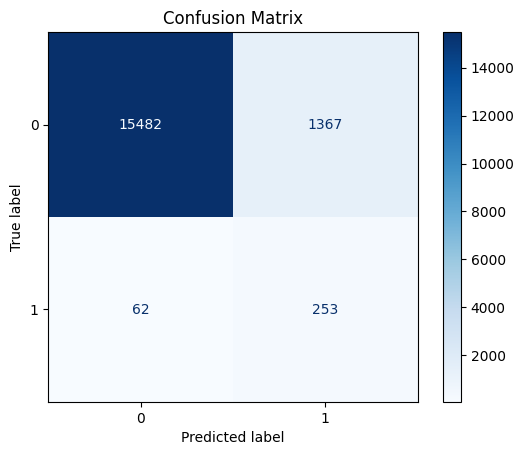

In [13]:

# Standard Scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

# Logistic Regression Classifier
clf = LogisticRegression(
    random_state=42,
    class_weight="balanced",  # Handle class imbalance
)
clf.fit(X_train_scaled, y_train)

# Predictions
y_pred = clf.predict(X_valid_scaled)
y_pred_proba = clf.predict_proba(X_valid_scaled)[:, 1]

# Evaluation Metrics
f1 = f1_score(y_valid, y_pred)
roc_auc = roc_auc_score(y_valid, y_pred_proba)

print(f"F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {roc_auc:.4f}")
print("\nClassification Report:\n", classification_report(y_valid, y_pred))

# Confusion Matrix
# Confusion Matrix Visualization
ConfusionMatrixDisplay.from_predictions(
    y_valid,
    y_pred,
    display_labels=clf.classes_,
    cmap=plt.cm.Blues
)
plt.title("Confusion Matrix")
plt.show()


### FEATURE IMPORTANCE

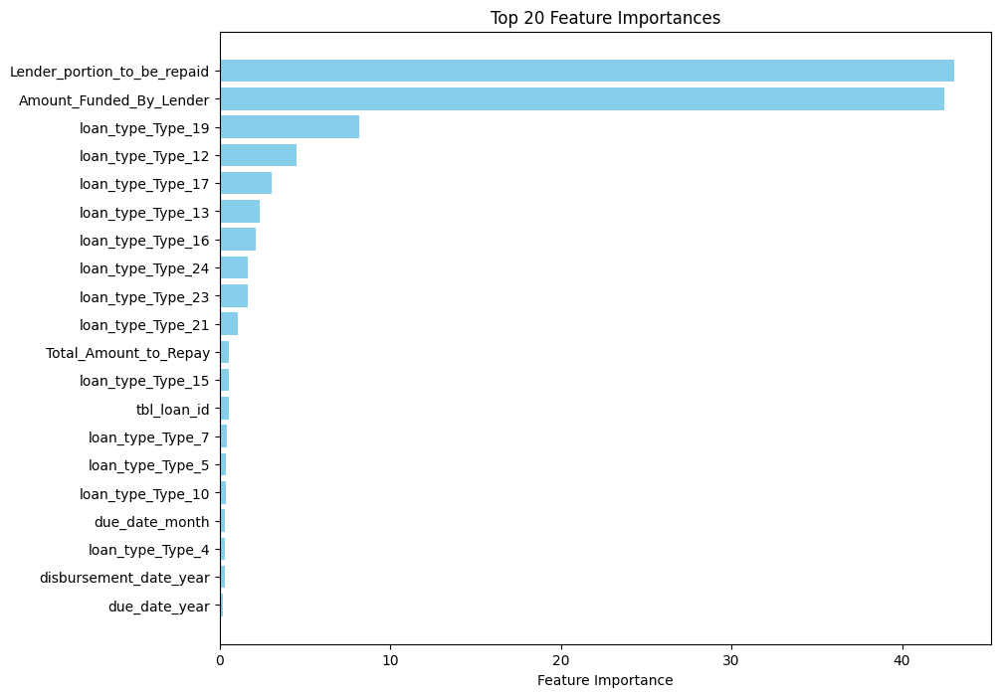

In [14]:
# Feature Importance

# Get the absolute values of the coefficients
feature_importances = np.abs(clf.coef_).flatten()

# Create a DataFrame for feature importance
importance_df = pd.DataFrame({
    'Feature': features_for_modelling,
    'Importance': feature_importances
})

# Sort by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False).head(20)

# Plot the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(importance_df['Feature'], importance_df['Importance'], color='skyblue')
plt.gca().invert_yaxis()  # To display the most important feature at the top
plt.xlabel('Feature Importance')
plt.title('Top 20 Feature Importances')
plt.show()

## Model Prediction & Inference

In [15]:
# Make predictions on the test dataset
test_predictions = clf.predict(test_df[features_for_modelling])
test_predictions_proba = clf.predict_proba(test_df[features_for_modelling])[:, 1]

# Save the predictions to a CSV file

test_df['target'] = test_predictions
sub =  test_df[['ID', 'target']]
sub.head()


,ID,target
68654,ID_269404226088267278,0
68655,ID_255356300042267278,0
68656,ID_257026243764267278,0
68657,ID_264617299409267278,0
68658,ID_247613296713267278,0


In [16]:
sub.to_csv('baseline_submission.csv', index=False)

#### To Do
* Handle imbalance
* Do more feature engineering
* Use more sophisticated machine learning algorithms
##### Good luck

train['target].value_counts()